# Designing and evaluating an online reinforcement learning agent for physical exercise recommendations in N-of-1 trials
This notebook is used to evaluate the performance for the RL agent using data from the simulate_data.ipynb notebook.

## Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
# Generic Imports
import pandas as pd
import pandas
import seaborn as sns
import matplotlib.pylab as plt
import numpy as np
import arviz as az
import arviz
import numpy
import hvplot
import holoviews
import random
import itertools
from tqdm.notebook import tqdm
from bokeh.io import show
from bokeh.layouts import column
import jsonpickle

In [3]:
# Simulation Library Imports
from nof1rl4endo import *

### Load from disk

In [4]:
## Load jsonpickle from disk:
parallel = True
if parallel:
    appendices = [f"_parallel_scenario_{index}" for index in range(7)]
else:
    appendices = [""]

calculated_series = []
config_to_simulation_data = {}

filenames = [f"../data/2023-11-08-data{appendix}.json" for appendix in appendices]
for filename in filenames:
    with open(filename, "r") as file:
        new_calculated_series, new_config_to_simulation_data = jsonpickle.decode(file.read())
    calculated_series.extend(new_calculated_series)
    config_to_simulation_data.update(new_config_to_simulation_data)

## Analysis

### Allocations

In [5]:
titles = [
    f"{entry['result'].simulations[0].model}, {entry['result'].simulations[0].policy}"
    for entry in calculated_series
]


def plot_allocations(calculated_series, titles, treatment_name):
    panels = [
        entry["result"].plot_allocations(treatment_name) for entry in calculated_series
    ]
    for title, panel in zip(titles, panels):
        panel.opts(title=title)
    return holoviews.Layout(panels).cols(1)


plot_allocations(calculated_series, titles, treatment_name="selection_index")

/opt/homebrew/Caskroom/miniconda/base/envs/mt/lib/python3.11/site-packages/holoviews/plotting/bokeh/plot.py:987: UserWarning: found multiple competing values for 'toolbar.active_drag' property; using the latest value
  layout_plot = gridplot(
/opt/homebrew/Caskroom/miniconda/base/envs/mt/lib/python3.11/site-packages/holoviews/plotting/bokeh/plot.py:987: UserWarning: found multiple competing values for 'toolbar.active_scroll' property; using the latest value
  layout_plot = gridplot(


:Layout
   .HeatMap.I     :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.II    :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.III   :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.IV    :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.V     :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.VI    :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.VII   :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.VIII  :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.IX    :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.X     :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.XI    :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.XII   :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.XIII  :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.XIV   :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.XV    :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.XVI   :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.XVII  :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.XVIII :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.XIX   :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.XX    :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)
   .HeatMap.XXI   :HeatMap   [t,patient_id]   (selection_index,debug_info,context,outcome,counterfactual_outcomes,selection_index)

## Custom Metric Definitions and Processing

In [6]:
# Filter only the observations where Thompson Sampling was used
ab_randomization_str = "ComposedPolicy(['SelectionPolicyFixedPolicy\\n', 'SelectionPolicyFixedPolicy\\n', 'SelectionPolicyThompsonSampling(PhysicalExerciseModel)'])"
ba_randomization_str = "ComposedPolicy(['SelectionPolicyFixedPolicy\\n', 'SelectionPolicyThompsonSampling(PhysicalExerciseModel)', 'SelectionPolicyFixedPolicy\\n'])"


CUT_TO_ADAPTIVE_INTERVENTIONS = True
if CUT_TO_ADAPTIVE_INTERVENTIONS:
    ab_randomization_start = 21
    ba_randomization_start = 7
    for entry in calculated_series:
        start = None
        if entry["configuration"]["policy"] == ab_randomization_str:
            start = ab_randomization_start
        if entry["configuration"]["policy"] == ba_randomization_str:
            start = ba_randomization_start

        if start is not None:
            result = entry["result"]
            simulations = result.simulations
            for simulation in simulations:
                simulation.history = simulation.history[start : start + 14]

series = [entry["result"] for entry in calculated_series]

In [7]:
def switch_to_fixed_policy(config):
    config = config.copy()
    config[
        "policy"
    ] = "ComposedPolicy(['SelectionPolicyFixedPolicy\\n', 'SelectionPolicyFixedPolicy\\n', 'SelectionPolicyFixedPolicy\\n'])"
    return config


metrics = [
    Entropy(outcome_name="type"),
    StandardDeviation(treatment_name="intensity"),
    StandardDeviation(treatment_name="duration"),
    RegretAgainstOtherConfiguration(
        outcome_name="pain_reduction",
        name="FixedPolicy",
        configuration_transform_function=switch_to_fixed_policy,
        config_to_simulation_data=config_to_simulation_data,
    ),
    ProbabilityIntervalMin(
        policy_filter_names=[ab_randomization_str, ba_randomization_str]
    ),
    ProbabilityIntervalMax(
        policy_filter_names=[ab_randomization_str, ba_randomization_str]
    ),
]

## Plot sum of rewards (debug output)

<Axes: xlabel='t', ylabel='Regret'>

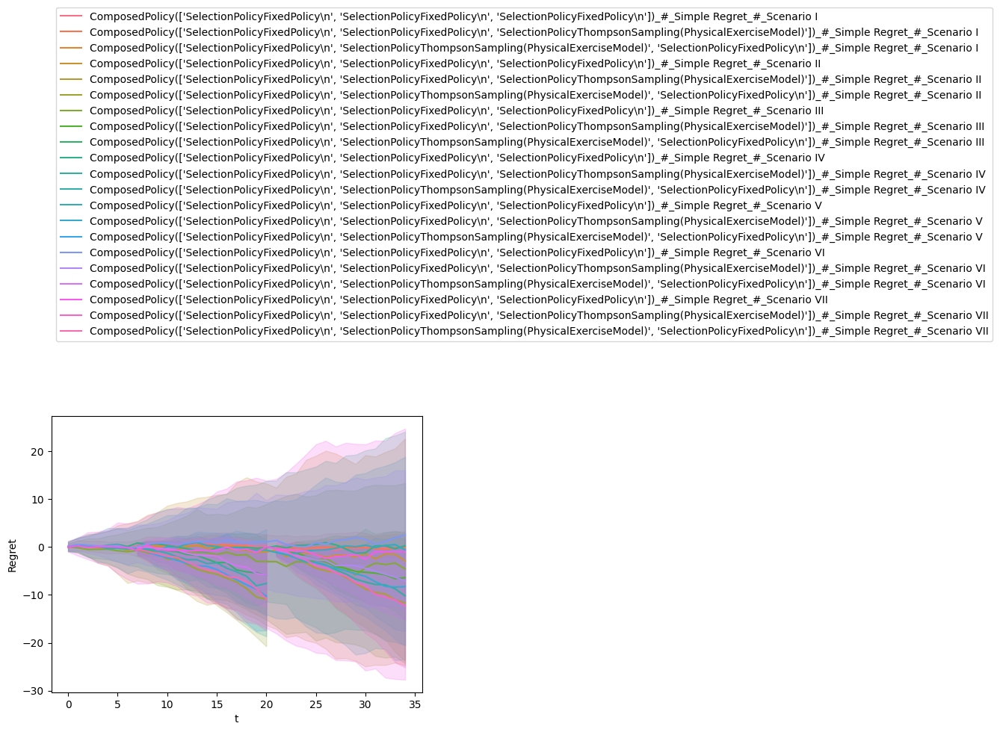

In [8]:
SeriesOfSimulationsData.plot_lines(
    series, [SimpleRegret(outcome_name="pain_reduction")], legend_position=(0, 2.5)
)

## Paper output generation

### Table

In [9]:
name_mapping = {
    "ComposedPolicy(['SelectionPolicyFixedPolicy\\n', 'SelectionPolicyFixedPolicy\\n', 'SelectionPolicyFixedPolicy\\n'])": "Fixed",
    "ComposedPolicy(['SelectionPolicyFixedPolicy\\n', 'SelectionPolicyFixedPolicy\\n', 'SelectionPolicyThompsonSampling(PhysicalExerciseModel)'])": "AB Randomization",
    "ComposedPolicy(['SelectionPolicyFixedPolicy\\n', 'SelectionPolicyThompsonSampling(PhysicalExerciseModel)', 'SelectionPolicyFixedPolicy\\n'])": "BA Randomization",
}

df = SeriesOfSimulationsData.score_data(
    series, metrics, {"policy": lambda x: name_mapping[x]}
)
filtered_df = df.loc[
    (
        (df["policy"] == "AB Randomization") & (df["t"] == 34)
        | (df["policy"] == "BA Randomization") & (df["t"] == 20)
        | (df["policy"] == "Fixed") & (df["t"] == 34)
    )
]
filtered_df

,t,score,simulation,patient_id,model,policy,metric
34,34,1.225920,SimulationData,0,Scenario I,Fixed,Entropy (type)
34,34,1.225920,SimulationData,1,Scenario I,Fixed,Entropy (type)
34,34,1.225920,SimulationData,2,Scenario I,Fixed,Entropy (type)
34,34,1.225920,SimulationData,3,Scenario I,Fixed,Entropy (type)
34,34,1.225920,SimulationData,4,Scenario I,Fixed,Entropy (type)
...,...,...,...,...,...,...,...
13,20,0.543875,SimulationData,95,Scenario VII,BA Randomization,ProbabilityIntervalMax
13,20,0.441250,SimulationData,96,Scenario VII,BA Randomization,ProbabilityIntervalMax
13,20,0.378500,SimulationData,97,Scenario VII,BA Randomization,ProbabilityIntervalMax
13,20,0.555125,SimulationData,98,Scenario VII,BA Randomization,ProbabilityIntervalMax


In [10]:
filtered_score_groupby = filtered_df.groupby(["model", "policy", "metric"])
means_table = filtered_score_groupby["score"].mean().unstack().unstack()
quantile_table = filtered_score_groupby["score"].quantile(0.75).unstack().unstack()

randomizations = ["AB Randomization", "BA Randomization"]

In [11]:
groupby_columns = ["model", "policy"]
pivoted_df = filtered_df.pivot(
    index=["model", "policy", "simulation", "patient_id"],
    columns="metric",
    values="score",
)
table = pivoted_df.groupby(groupby_columns).mean()

table["Regret 0.75 quantile"] = pivoted_df.groupby(groupby_columns).quantile(0.75)[
    "RegretAgainstOtherConfiguration(FixedPolicy)"
]
table = table.loc[(slice(None), randomizations), :]

In [12]:
table

metric                         Entropy (type)  ProbabilityIntervalMax  \
model        policy                                                     
Scenario I   AB Randomization        1.102814                0.290960   
             BA Randomization        1.119431                0.342670   
Scenario II  AB Randomization        0.817251                0.436615   
             BA Randomization        0.901510                0.457271   
Scenario III AB Randomization        0.931127                0.355801   
             BA Randomization        0.984060                0.391655   
Scenario IV  AB Randomization        0.847187                0.430270   
             BA Randomization        0.948705                0.442408   
Scenario V   AB Randomization        0.806610                0.419783   
             BA Randomization        0.897259                0.443028   
Scenario VI  AB Randomization        0.858031                0.420715   
             BA Randomization        0.956070                0.428310   
Scenario VII AB Randomization        0.815592                0.439020   
             BA Randomization        0.974375                0.431865   

metric                         ProbabilityIntervalMin  \
model        policy                                     
Scenario I   AB Randomization                0.047571   
             BA Randomization                0.029885   
Scenario II  AB Randomization                0.011147   
             BA Randomization                0.013119   
Scenario III AB Randomization                0.025409   
             BA Randomization                0.022437   
Scenario IV  AB Randomization                0.013540   
             BA Randomization                0.015845   
Scenario V   AB Randomization                0.012679   
             BA Randomization                0.013142   
Scenario VI  AB Randomization                0.014790   
             BA Randomization                0.017439   
Scenario VII AB Randomization                0.014103   
             BA Randomization                0.018247   

metric                         RegretAgainstOtherConfiguration(FixedPolicy)  \
model        policy                                                           
Scenario I   AB Randomization                                      0.000000   
             BA Randomization                                      0.000000   
Scenario II  AB Randomization                                    -11.764300   
             BA Randomization                                    -10.500829   
Scenario III AB Randomization                                     -5.119624   
             BA Randomization                                     -4.397981   
Scenario IV  AB Randomization                                     -9.981912   
             BA Randomization                                     -8.319939   
Scenario V   AB Randomization                                    -10.739166   
             BA Randomization                                     -9.475205   
Scenario VI  AB Randomization                                     -8.760563   
             BA Randomization                                     -7.023064   
Scenario VII AB Randomization                                    -11.742124   
             BA Randomization                                     -8.374596   

metric                         std(duration)  std(intensity)  \
model        policy                                            
Scenario I   AB Randomization       0.254052        0.301147   
             BA Randomization       0.269954        0.308369   
Scenario II  AB Randomization       0.222876        0.248041   
             BA Randomization       0.238515        0.265696   
Scenario III AB Randomization       0.233330        0.261147   
             BA Randomization       0.255714        0.280982   
Scenario IV  AB Randomization       0.219563        0.254189   
             BA Randomization       0.247859        0.281593   
Scenario V   

In [13]:
print(
    table[
        [
            "RegretAgainstOtherConfiguration(FixedPolicy)",
            "Regret 0.75 quantile",
            "Entropy (type)",
            "std(duration)",
            "std(intensity)",
            "ProbabilityIntervalMax",
            "ProbabilityIntervalMin",
        ]
    ]
    .style.format(precision=2)
    .to_latex()
)

\begin{tabular}{llrrrrrrr}
 & metric & RegretAgainstOtherConfiguration(FixedPolicy) & Regret 0.75 quantile & Entropy (type) & std(duration) & std(intensity) & ProbabilityIntervalMax & ProbabilityIntervalMin \\
model & policy &  &  &  &  &  &  &  \\
\multirow[c]{2}{*}{Scenario I} & AB Randomization & 0.00 & 0.00 & 1.10 & 0.25 & 0.30 & 0.29 & 0.05 \\
 & BA Randomization & 0.00 & 0.00 & 1.12 & 0.27 & 0.31 & 0.34 & 0.03 \\
\multirow[c]{2}{*}{Scenario II} & AB Randomization & -11.76 & -5.24 & 0.82 & 0.22 & 0.25 & 0.44 & 0.01 \\
 & BA Randomization & -10.50 & -4.40 & 0.90 & 0.24 & 0.27 & 0.46 & 0.01 \\
\multirow[c]{2}{*}{Scenario III} & AB Randomization & -5.12 & -0.63 & 0.93 & 0.23 & 0.26 & 0.36 & 0.03 \\
 & BA Randomization & -4.40 & -0.56 & 0.98 & 0.26 & 0.28 & 0.39 & 0.02 \\
\multirow[c]{2}{*}{Scenario IV} & AB Randomization & -9.98 & -4.46 & 0.85 & 0.22 & 0.25 & 0.43 & 0.01 \\
 & BA Randomization & -8.32 & -3.47 & 0.95 & 0.25 & 0.28 & 0.44 & 0.02 \\
\multirow[c]{2}{*}{Scenario V} & AB R

### Figures

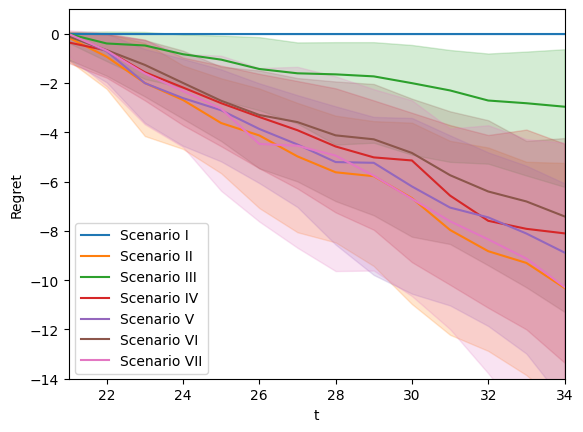

In [14]:
# AB Randomization Plot
series_to_plot = [
    entry["result"]
    for entry in calculated_series
    if str(entry["result"].simulations[0].policy)
    == "ComposedPolicy(['SelectionPolicyFixedPolicy\\n', 'SelectionPolicyFixedPolicy\\n', 'SelectionPolicyThompsonSampling(PhysicalExerciseModel)'])"
]
metrics = [
    RegretAgainstOtherConfiguration(
        outcome_name="pain_reduction",
        name="FixedPolicy",
        configuration_transform_function=switch_to_fixed_policy,
        config_to_simulation_data=config_to_simulation_data,
    ),
]
SeriesOfSimulationsData.plot_lines(
    series_to_plot, metrics, hue="model", legend_position=(0, 0.44)
)
plt.xlim(21, 34)
plt.ylim([-14, 1])


plt.savefig("regret_over_time_AB.pdf", bbox_inches="tight")

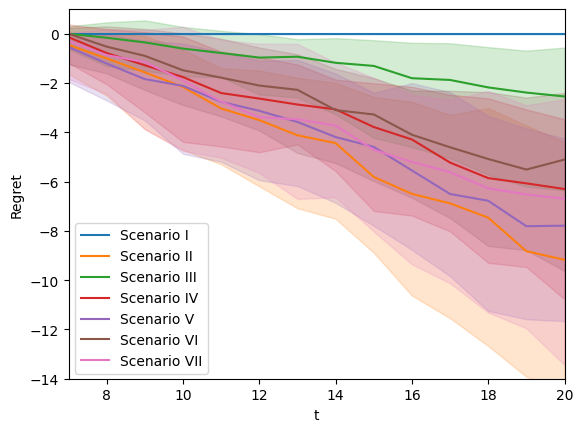

In [15]:
# BA Randomization Plot
series_to_plot = [
    entry["result"]
    for entry in calculated_series
    if str(entry["result"].simulations[0].policy)
    == "ComposedPolicy(['SelectionPolicyFixedPolicy\\n', 'SelectionPolicyThompsonSampling(PhysicalExerciseModel)', 'SelectionPolicyFixedPolicy\\n'])"
]
metrics = [
    RegretAgainstOtherConfiguration(
        outcome_name="pain_reduction",
        name="FixedPolicy",
        configuration_transform_function=switch_to_fixed_policy,
        config_to_simulation_data=config_to_simulation_data,
    ),
]
SeriesOfSimulationsData.plot_lines(
    series_to_plot, metrics, hue="model", legend_position=(0, 0.44)
)

plt.xlim(7, 20)
plt.ylim([-14, 1])
plt.savefig("regret_over_time_BA.pdf", bbox_inches="tight")

## Calculate Entropy and Standard Deviation for the fixed treatment sequence

In [16]:
df.loc[(df["policy"] == "Fixed") & (df["t"] == 13)].groupby("metric").mean(
    numeric_only=True
)

,t,score
metric,,
Entropy (type),13.0,1.225920
ProbabilityIntervalMax,13.0,0.000000
ProbabilityIntervalMin,13.0,0.000000
RegretAgainstOtherConfiguration(FixedPolicy),13.0,0.000000
std(duration),13.0,0.261846
std(intensity),13.0,0.315633
